In [1]:
#from sklearn import model_selection

In [2]:
#from sklearn import ensemble as es

In [3]:
#es.boos

In [4]:
#import kagglehub

In [5]:
#from statsmodels.tsa.arima.model import ARIMA

In [5]:
import os
os.chdir("../")
from pathlib import Path

In [7]:
import numpy as np
import pandas as pd
from datetime import datetime
from zipfile import ZipFile
import missingno as msno

import plotly.express as px
import plotly.graph_objects as go

import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.style as style

style.use("bmh")
plt.rcParams['font.family'] = 'Trebuchet MS'

matplotlib.rcParams['font.size'] = 15

In [8]:
from pathlib import Path
features_path=Path.cwd()/"artifacts"/"data_injestion"/"dataset1"/"train.csv"
train_path=Path.cwd()/"artifacts"/"data_injestion"/"dataset1"/"train.csv"
stores_path=Path.cwd()/"artifacts"/"data_injestion"/"dataset1"/"stores.csv"
#dataset="artifacts/data_injestion"
df2=pd.read_csv(features_path)
df1=pd.read_csv(train_path)
df3=pd.read_csv(stores_path)
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45 entries, 0 to 44
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Store   45 non-null     int64 
 1   Type    45 non-null     object
 2   Size    45 non-null     int64 
dtypes: int64(2), object(1)
memory usage: 1.2+ KB


In [9]:
data=df1.merge(df2,on=['Store', 'Date', 'IsHoliday'],how='inner')
final_data=data.merge(df3,on=['Store'],how='inner')

In [10]:
final_data.head()

,Store,Dept_x,Date,Weekly_Sales_x,IsHoliday,Dept_y,Weekly_Sales_y,Type,Size
0,1,1,2010-02-05,24924.5,False,1,24924.50,A,151315
1,1,1,2010-02-05,24924.5,False,2,50605.27,A,151315
2,1,1,2010-02-05,24924.5,False,3,13740.12,A,151315
3,1,1,2010-02-05,24924.5,False,4,39954.04,A,151315
4,1,1,2010-02-05,24924.5,False,5,32229.38,A,151315


In [11]:
final_data["Date"]=pd.to_datetime(final_data["Date"])
final_data.head()

,Store,Dept_x,Date,Weekly_Sales_x,IsHoliday,Dept_y,Weekly_Sales_y,Type,Size
0,1,1,2010-02-05,24924.5,False,1,24924.50,A,151315
1,1,1,2010-02-05,24924.5,False,2,50605.27,A,151315
2,1,1,2010-02-05,24924.5,False,3,13740.12,A,151315
3,1,1,2010-02-05,24924.5,False,4,39954.04,A,151315
4,1,1,2010-02-05,24924.5,False,5,32229.38,A,151315


<Axes: >

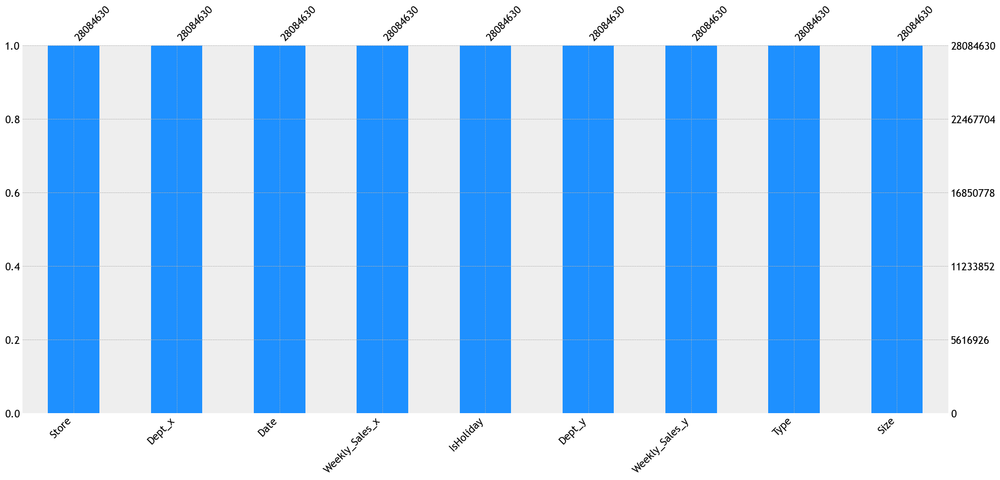

In [12]:
msno.bar(final_data,color="dodgerblue")

In [13]:
final_data.isnull().mean().round(4)*100

Store             0.0
Dept_x            0.0
Date              0.0
Weekly_Sales_x    0.0
IsHoliday         0.0
Dept_y            0.0
Weekly_Sales_y    0.0
Type              0.0
Size              0.0
dtype: float64

In [14]:
final_data["Year"]=final_data["Date"].dt.year
final_data["Month"]=final_data["Date"].dt.month
final_data["Week"]=final_data["Date"].dt.isocalendar().week
final_data["Day_Name"]=final_data["Date"].dt.day_name
final_data["Month_Name"]=final_data["Date"].dt.month_name

In [15]:
week_2010=final_data[final_data['Year']==2010].groupby('Week')['Weekly_Sales_x'].mean()
week_2011=final_data[final_data['Year']==2011].groupby('Week')['Weekly_Sales_x'].mean()
week_2012=final_data[final_data['Year']==2012].groupby('Week')['Weekly_Sales_x'].mean()

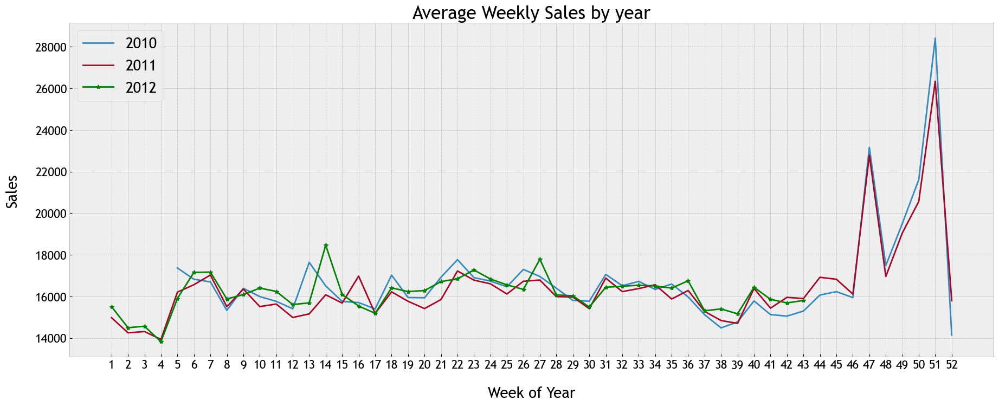

In [16]:
plt.figure(figsize=(22,8))
plt.plot(week_2010.index, week_2010.values)
plt.plot(week_2011.index, week_2011.values)
plt.plot(week_2012.index, week_2012.values, '*-g')

plt.xticks(np.arange(1, 53, step=1), fontsize=16)
plt.yticks( fontsize=16)
plt.xlabel('Week of Year', fontsize=20, labelpad=20)
plt.ylabel('Sales', fontsize=20, labelpad=20)

plt.title("Average Weekly Sales by year", fontsize=24)
plt.legend(['2010', '2011', '2012'], fontsize=20)

In [17]:
best_stores = final_data[final_data['Store'].isin([20,4,14,13,2])]
fig = px.box(best_stores, y='Weekly_Sales_x', x='Store', color="Store", 
             title="Top 5 store distribution analysis",
             template='plotly+presentation',
             color_discrete_sequence = px.colors.qualitative.Set1)
            
fig.update_layout(
    title={
        'y':0.92,
        'x':0.5},
    font=dict(
        family='Trebuchet MS',
        size=15),
    legend={
        'y': 0.85,
        'x': 0.85,
        'xanchor': 'right',
        'yanchor': 'top'},
    yaxis_title = 'Sales',
    xaxis_title = 'Store',
    showlegend = False,
    xaxis=dict(type='category')
)

fig.update_xaxes(categoryorder='total descending')

fig.show()

In [18]:
holiday={6:"Super Bowl", 36:"Labor day", 47:"Thanksgiving", 51:"Christmas"}

holidays=final_data[final_data["Week"].isin([6,36,47,51])]
holiday_mean=holidays[["Weekly_Sales_x","Week"]].groupby("Week").mean().reset_index().sort_values('Weekly_Sales_x',ascending=False)
holiday_mean=holiday_mean.rename(columns={"Week":"Holiday"})
holiday_mean["Holiday"]=holiday_mean["Holiday"].map(holiday)
holiday_mean

,Holiday,Weekly_Sales_x
3,Christmas,27355.618318
2,Thanksgiving,22971.476516
0,Super Bowl,16850.166929
1,Labor day,16338.470318


In [19]:
fig=px.bar(holiday_mean,x="Holiday",y="Weekly_Sales_x",
            color="Holiday",
            title = 'Sales average by holiday',
            template = 'plotly+presentation',
            text_auto=".2s",
            color_discrete_sequence = px.colors.qualitative.Pastel)
fig.show()

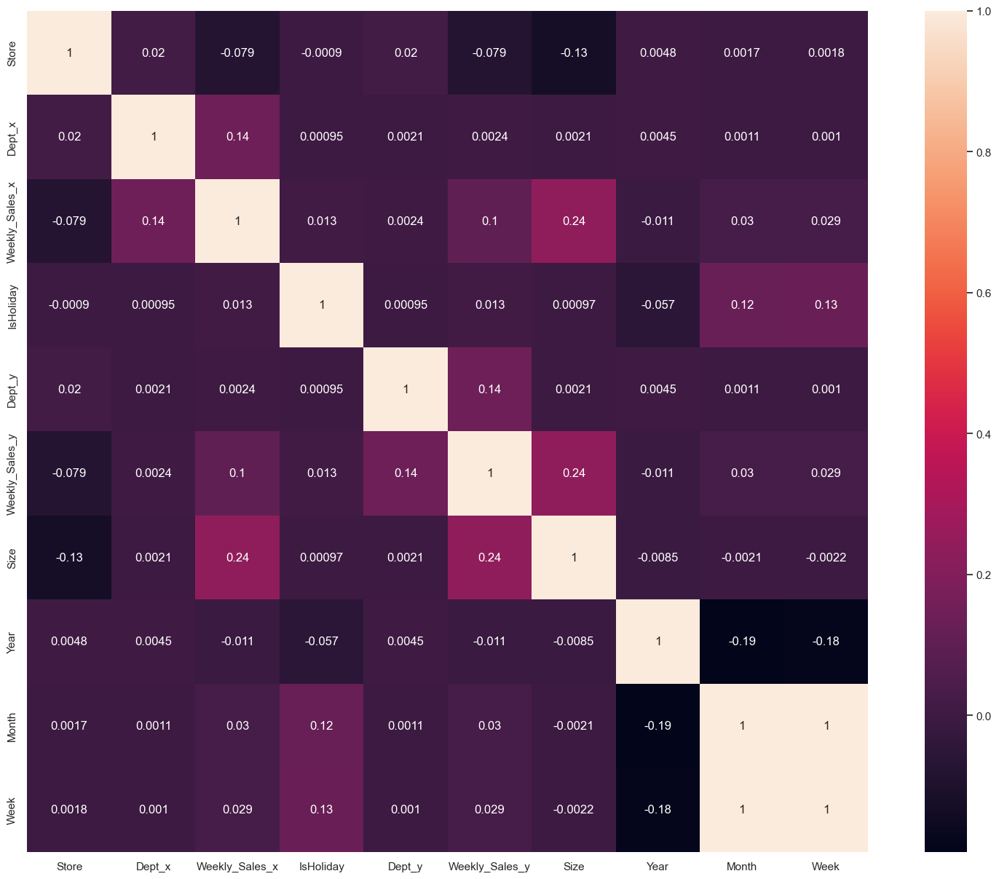

In [20]:
sns.set(style="white")
corr=final_data.corr(numeric_only=True)
plt.subplots(figsize=(20, 15))
sns.heatmap(corr,square=True,annot=True)
plt.show()

In [21]:
final_data.head()

,Store,Dept_x,Date,Weekly_Sales_x,IsHoliday,Dept_y,Weekly_Sales_y,Type,Size,Year,Month,Week,Day_Name,Month_Name
0,1,1,2010-02-05,24924.5,False,1,24924.50,A,151315,2010,2,5,<bound method PandasDelegate._add_delegate_acc...,<bound method PandasDelegate._add_delegate_acc...
1,1,1,2010-02-05,24924.5,False,2,50605.27,A,151315,2010,2,5,<bound method PandasDelegate._add_delegate_acc...,<bound method PandasDelegate._add_delegate_acc...
2,1,1,2010-02-05,24924.5,False,3,13740.12,A,151315,2010,2,5,<bound method PandasDelegate._add_delegate_acc...,<bound method PandasDelegate._add_delegate_acc...
3,1,1,2010-02-05,24924.5,False,4,39954.04,A,151315,2010,2,5,<bound method PandasDelegate._add_delegate_acc...,<bound method PandasDelegate._add_delegate_acc...
4,1,1,2010-02-05,24924.5,False,5,32229.38,A,151315,2010,2,5,<bound method PandasDelegate._add_delegate_acc...,<bound method PandasDelegate._add_delegate_acc...


In [22]:
from prophet import Prophet
from prophet.plot import plot_plotly
from prophet.plot import add_changepoints_to_plot
from prophet.plot import plot_plotly, plot_components_plotly
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error, r2_score

In [32]:

results={}

for store in final_data['Store'].unique():
    store_x=final_data[final_data['Store']==store]
    store_x=store_x[['Date','Weekly_Sales_x']]
    store_x=store_x.groupby('Date').sum()
    store_x.reset_index(inplace=True)
    store_x['Date'] = pd.to_datetime(store_x['Date'])

    store_x=store_x[['Date','Weekly_Sales_x']]
    store_x.columns=['ds','y']

    y_train = store_x.iloc[:120]
    y_test = store_x.iloc[120:]

    model=Prophet()
    model.fit(y_train)

    future=model.make_future_dataframe(periods=23,freq='W-Fri')
    forecast=model.predict(future)
    y_pred=forecast['yhat'].tail(len(y_test)).values

    mape=round(mean_absolute_percentage_error(y_test['y'].values,y_pred),4)*100
    mae=round(mean_absolute_error(y_test['y'].values,y_pred),4)

    results[store]=[mape,mae]

23:00:32 - cmdstanpy - INFO - Chain [1] start processing
23:00:32 - cmdstanpy - INFO - Chain [1] done processing
23:00:33 - cmdstanpy - INFO - Chain [1] start processing
23:00:33 - cmdstanpy - INFO - Chain [1] done processing
23:00:33 - cmdstanpy - INFO - Chain [1] start processing
23:00:33 - cmdstanpy - INFO - Chain [1] done processing
23:00:33 - cmdstanpy - INFO - Chain [1] start processing
23:00:34 - cmdstanpy - INFO - Chain [1] done processing
23:00:34 - cmdstanpy - INFO - Chain [1] start processing
23:00:34 - cmdstanpy - INFO - Chain [1] done processing
23:00:34 - cmdstanpy - INFO - Chain [1] start processing
23:00:34 - cmdstanpy - INFO - Chain [1] done processing
23:00:35 - cmdstanpy - INFO - Chain [1] start processing
23:00:35 - cmdstanpy - INFO - Chain [1] done processing
23:00:35 - cmdstanpy - INFO - Chain [1] start processing
23:00:35 - cmdstanpy - INFO - Chain [1] done processing
23:00:35 - cmdstanpy - INFO - Chain [1] start processing
23:00:35 - cmdstanpy - INFO - Chain [1]

In [33]:
results = pd.DataFrame(results)
results = results.transpose()
results.reset_index(inplace=True)
results.columns = ['Store', 'MAPE', 'MAE']
results

,Store,MAPE,MAE
0,1,3.92,4.451714e+06
1,2,4.54,6.246158e+06
2,3,3.49,9.260959e+05
3,4,3.44,5.292628e+06
4,5,3.83,7.601411e+05
5,6,3.58,4.085731e+06
6,7,6.82,2.763764e+06
7,8,3.46,2.172738e+06
8,9,6.16,2.081302e+06
9,10,3.21,4.011243e+06


In [35]:
# Check your data units and scaling
print("Sample actual values:", y_test['y'].head())
print("Sample predicted values:", y_pred[:5])
print("Data types:", y_test['y'].dtype, type(y_pred[0]))

# Check for unit mismatches (thousands, millions, etc.)
print("Scale check:")
print(f"Max actual: {y_test['y'].max():,}")
print(f"Max predicted: {y_pred.max():,}")


Sample actual values: 120    54788658.39
121    56088690.21
122    52478778.00
123    55861876.24
124    55934702.88
Name: y, dtype: float64
Sample predicted values: [55459906.59090172 55289088.18024261 55487643.07048887 56234835.74501227
 56201143.68385478]
Data types: float64 <class 'numpy.float64'>
Scale check:
Max actual: 56,088,690.21
Max predicted: 56,234,835.74501227


In [ ]:
import os
import pickle
import pandas as pd
import numpy as np
from pathlib import Path
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error
from typing import Dict, Any
from src.retailDemand.entity.config_entity import RetailForecastingConfig
from src.retailDemand.utils.common import createDir
from src.retailDemand import logger


class RetailDemandForecaster:
    def __init__(self, config: RetailForecastingConfig):
        self.config = config
        self.data = None
        self.models = {}
        self.results = {}
        self.forecasts = {}
        
        # Use your existing logger instead of creating new one
        self.logger = logger
        
        # Create directories
        createDir([
            self.config.root_dir,
            self.config.model_dir,
            self.config.results_dir
        ])
    
    def load_and_merge_data(self) -> pd.DataFrame:
        """Load and merge the three CSV files - your exact logic"""
        try:
            # Define paths using your approach
            features_path = self.config.dataset_dir / "features.csv"
            train_path = self.config.dataset_dir / "train.csv"
            stores_path = self.config.dataset_dir / "stores.csv"
            
            # Load CSVs - your exact code
            self.logger.info("Loading CSV files from dataset directory")
            df2 = pd.read_csv(features_path)  # features
            df1 = pd.read_csv(train_path)     # train
            df3 = pd.read_csv(stores_path)    # stores
            
            self.logger.info(f"Loaded features: {df2.shape}")
            self.logger.info(f"Loaded train: {df1.shape}")
            self.logger.info(f"Loaded stores: {df3.shape}")
            
            # Merge data - your exact logic
            data = df1.merge(df2, on=['Store', 'Date', 'IsHoliday'], how='inner')
            final_data = data.merge(df3, on=['Store'], how='inner')
            
            # Convert Date column to datetime
            final_data['Date'] = pd.to_datetime(final_data['Date'])
            
            # Create additional features
            final_data['Year'] = final_data['Date'].dt.year
            final_data['Month'] = final_data['Date'].dt.month
            final_data['Week'] = final_data['Date'].dt.isocalendar().week
            final_data['Day_Name'] = final_data['Date'].dt.day_name()
            final_data['Month_Name'] = final_data['Date'].dt.month_name()
            
            # Ensure Weekly_Sales_x column exists
            if 'Weekly_Sales' in final_data.columns and 'Weekly_Sales_x' not in final_data.columns:
                final_data['Weekly_Sales_x'] = final_data['Weekly_Sales']
            
            self.data = final_data
            self.logger.info(f"Final merged data shape: {final_data.shape}")
            self.logger.info(f"Columns: {list(final_data.columns)}")
            
            return final_data
            
        except Exception as e:
            self.logger.error(f"Error loading and merging data: {str(e)}")
            raise
    
    def prepare_store_data(self, store_id: int) -> pd.DataFrame:
        """Prepare time series data for a specific store"""
        if self.data is None:
            raise ValueError("Data not loaded. Call load_and_merge_data() first.")
        
        store_data = self.data[self.data[self.config.store_column] == store_id]
        
        # Aggregate by date
        store_data = store_data[[self.config.date_column, self.config.target_column]]
        store_data = store_data.groupby(self.config.date_column).sum()
        store_data.reset_index(inplace=True)
        
        # Rename columns for Prophet
        store_data.columns = ['ds', 'y']
        
        self.logger.info(f"Prepared data for store {store_id}. Shape: {store_data.shape}")
        return store_data
    
    def create_base_model(self) -> Prophet:
        """Create and configure Prophet base model"""
        model = Prophet(
            daily_seasonality=self.config.daily_seasonality,
            weekly_seasonality=self.config.weekly_seasonality,
            yearly_seasonality=self.config.yearly_seasonality,
            seasonality_mode=self.config.seasonality_mode
        )
        return model
    
    def train_store_model(self, store_id: int) -> Prophet:
        """Train Prophet model for a specific store"""
        try:
            self.logger.info(f"Training model for store {store_id}")
            store_data = self.prepare_store_data(store_id)
            
            # Split data
            train_data = store_data.iloc[:self.config.train_split]
            
            # Create and train model
            model = self.create_base_model()
            model.fit(train_data)
            
            # Store the model
            self.models[store_id] = model
            
            self.logger.info(f"Model trained successfully for store {store_id}")
            return model
            
        except Exception as e:
            self.logger.error(f"Error training model for store {store_id}: {str(e)}")
            raise
    
    def predict_store(self, store_id: int) -> pd.DataFrame:
        """Generate predictions for a specific store"""
        if store_id not in self.models:
            raise ValueError(f"Model for store {store_id} not found. Train the model first.")
        
        model = self.models[store_id]
        
        # Create future dataframe
        future = model.make_future_dataframe(
            periods=self.config.forecast_periods, 
            freq=self.config.frequency
        )
        
        # Generate forecast
        forecast = model.predict(future)
        self.forecasts[store_id] = forecast
        
        self.logger.info(f"Predictions generated for store {store_id}")
        return forecast
    
    def evaluate_store_model(self, store_id: int) -> Dict[str, float]:
        """Evaluate model performance for a specific store"""
        store_data = self.prepare_store_data(store_id)
        test_data = store_data.iloc[self.config.train_split:]
        
        if store_id not in self.forecasts:
            self.predict_store(store_id)
        
        forecast = self.forecasts[store_id]
        y_pred = forecast['yhat'].tail(len(test_data)).values
        y_true = test_data['y'].values
        
        # Calculate furmetrics
        mape = mean_absolute_percentage_error(y_true, y_pred) * 100
        mae = mean_absolute_error(y_true, y_pred)
        
        metrics = {
            'MAPE': round(mape, 4),
            'MAE': round(mae, 4)
        }
        
        self.results[store_id] = metrics
        self.logger.info(f"Evaluation completed for store {store_id}: MAPE={mape:.2f}%")
        
        return metrics
    
    def train_all_stores(self) -> pd.DataFrame:
        """Train models for all stores - matches your original loop logic"""
        if self.data is None:
            self.load_and_merge_data()
        
        stores = self.data[self.config.store_column].unique()
        self.logger.info(f"Starting training for {len(stores)} stores")
        
        for store_id in stores:
            try:
                self.train_store_model(store_id)
                self.evaluate_store_model(store_id)
                self.logger.info(f"✓ Completed store {store_id}")
            except Exception as e:
                self.logger.error(f"✗ Failed to process store {store_id}: {str(e)}")
                continue
        
        # Return results in your original format
        results_df = pd.DataFrame.from_dict(self.results, orient='index')
        results_df.reset_index(inplace=True)
        results_df.columns = ['Store', 'MAPE', 'MAE']
        
        self.logger.info(f"Training completed for {len(self.models)} stores")
        return results_df
    
    def predict_sales(self, store_id: int, target_date: str) -> Dict[str, Any]:
        """Predict sales for a specific store and date"""
        if store_id not in self.models:
            available_stores = list(self.models.keys())
            raise ValueError(f"Model for store {store_id} not found. Available stores: {available_stores}")
        
        model = self.models[store_id]
        
        # Create future dataframe   
        future = pd.DataFrame({'ds': [pd.to_datetime(target_date)]})
        
        # Generate forecast
        forecast = model.predict(future)
        
        result = {
            'store_id': store_id,
            'prediction_date': target_date,
            'predicted_sales': round(forecast['yhat'].iloc[0], 2),
            'lower_bound': round(forecast['yhat_lower'].iloc[0], 2),
            'upper_bound': round(forecast['yhat_upper'].iloc[0], 2)
        }
        
        self.logger.info(f"Prediction completed for store {store_id} on {target_date}: ${result['predicted_sales']:,.2f}")
        return result
    
    def save_all_models(self) -> None:
        """Save all trained models"""
        self.logger.info("Saving all trained models")
        
        for store_id, model in self.models.items():
            model_path = self.config.model_dir / f"prophet_store_{store_id}.pkl"
            with open(model_path, 'wb') as f:
                pickle.dump(model, f)
        
        # Save models dictionary
        all_models_path = self.config.model_dir / "all_models.pkl"
        with open(all_models_path, 'wb') as f:
            pickle.dump(self.models, f)
        
        self.logger.info(f"All {len(self.models)} models saved successfully")
    
    def save_results(self) -> None:
        """Save evaluation results"""
        results_df = pd.DataFrame.from_dict(self.results, orient='index')
        results_df.reset_index(inplace=True)
        results_df.columns = ['Store', 'MAPE', 'MAE']
        
        results_path = self.config.results_dir / "model_evaluation_results.csv"
        results_df.to_csv(results_path, index=False)
        
        self.logger.info(f"Results saved to {results_path}")


In [8]:
from src.retailDemand.config.configuration import ConfigurationManager

# Initialize configuration
config_manager = ConfigurationManager()
retail_config = config_manager.getRetailForecastingConfig()

# Create forecaster (now uses your existing logger)
forecaster = RetailDemandForecaster(config=retail_config)

# Train all models
results_df = forecaster.train_all_stores()
print(results_df)

# Save models and results
forecaster.save_all_models()
forecaster.save_results()


[2025-09-13 23:39:55,638: INFO: common: yaml file: config\config.yaml loaded successfully]
[2025-09-13 23:39:55,658: INFO: common: yaml file: params.yaml loaded successfully]
[2025-09-13 23:39:55,660: INFO: common: Created directory at: artifacts]
[2025-09-13 23:39:55,662: INFO: common: Created directory at: artifacts/retail_forecasting]
[2025-09-13 23:39:55,664: INFO: common: Created directory at: artifacts\retail_forecasting]
[2025-09-13 23:39:55,667: INFO: common: Created directory at: artifacts\retail_forecasting\models]
[2025-09-13 23:39:55,668: INFO: common: Created directory at: artifacts\retail_forecasting\results]
[2025-09-13 23:39:55,670: INFO: 45006073: Loading CSV files from dataset directory]
[2025-09-13 23:39:55,959: INFO: 45006073: Loaded features: (8190, 12)]
[2025-09-13 23:39:55,960: INFO: 45006073: Loaded train: (421570, 5)]
[2025-09-13 23:39:55,962: INFO: 45006073: Loaded stores: (45, 3)]
[2025-09-13 23:39:56,628: INFO: 45006073: Final merged data shape: (421570, 22)

23:39:56 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:56,957: INFO: model: Chain [1] start processing]


23:39:57 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:57,118: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:57,141: INFO: 45006073: Model trained successfully for store 1]
[2025-09-13 23:39:57,148: INFO: 45006073: Prepared data for store 1. Shape: (143, 2)]
[2025-09-13 23:39:57,226: INFO: 45006073: Predictions generated for store 1]
[2025-09-13 23:39:57,230: INFO: 45006073: Evaluation completed for store 1: MAPE=3.56%]
[2025-09-13 23:39:57,232: INFO: 45006073: ✓ Completed store 1]
[2025-09-13 23:39:57,233: INFO: 45006073: Training model for store 2]
[2025-09-13 23:39:57,240: INFO: 45006073: Prepared data for store 2. Shape: (143, 2)]
[2025-09-13 23:39:57,243: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:57,308: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:57,329: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\61f6528c.json]
[2025-09-13 23:39:57,341: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\9_j08

23:39:57 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:57,347: INFO: model: Chain [1] start processing]


23:39:57 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:57,403: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:57,425: INFO: 45006073: Model trained successfully for store 2]
[2025-09-13 23:39:57,438: INFO: 45006073: Prepared data for store 2. Shape: (143, 2)]
[2025-09-13 23:39:57,528: INFO: 45006073: Predictions generated for store 2]
[2025-09-13 23:39:57,531: INFO: 45006073: Evaluation completed for store 2: MAPE=3.59%]
[2025-09-13 23:39:57,534: INFO: 45006073: ✓ Completed store 2]
[2025-09-13 23:39:57,537: INFO: 45006073: Training model for store 3]
[2025-09-13 23:39:57,550: INFO: 45006073: Prepared data for store 3. Shape: (143, 2)]
[2025-09-13 23:39:57,555: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:57,641: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:57,664: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\x234vibd.json]
[2025-09-13 23:39:57,679: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\uxj6_

23:39:57 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:57,687: INFO: model: Chain [1] start processing]


23:39:57 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:57,741: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:57,757: INFO: 45006073: Model trained successfully for store 3]
[2025-09-13 23:39:57,763: INFO: 45006073: Prepared data for store 3. Shape: (143, 2)]
[2025-09-13 23:39:57,836: INFO: 45006073: Predictions generated for store 3]
[2025-09-13 23:39:57,838: INFO: 45006073: Evaluation completed for store 3: MAPE=4.74%]
[2025-09-13 23:39:57,839: INFO: 45006073: ✓ Completed store 3]
[2025-09-13 23:39:57,842: INFO: 45006073: Training model for store 4]
[2025-09-13 23:39:57,850: INFO: 45006073: Prepared data for store 4. Shape: (143, 2)]
[2025-09-13 23:39:57,853: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:57,925: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:57,948: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\5lj462fs.json]
[2025-09-13 23:39:57,962: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\auzan

23:39:57 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:57,973: INFO: model: Chain [1] start processing]


23:39:58 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:58,039: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:58,066: INFO: 45006073: Model trained successfully for store 4]
[2025-09-13 23:39:58,078: INFO: 45006073: Prepared data for store 4. Shape: (143, 2)]
[2025-09-13 23:39:58,211: INFO: 45006073: Predictions generated for store 4]
[2025-09-13 23:39:58,215: INFO: 45006073: Evaluation completed for store 4: MAPE=3.20%]
[2025-09-13 23:39:58,216: INFO: 45006073: ✓ Completed store 4]
[2025-09-13 23:39:58,217: INFO: 45006073: Training model for store 5]
[2025-09-13 23:39:58,225: INFO: 45006073: Prepared data for store 5. Shape: (143, 2)]
[2025-09-13 23:39:58,229: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:58,311: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:58,352: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\bembq938.json]
[2025-09-13 23:39:58,370: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\7la4r

23:39:58 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:58,378: INFO: model: Chain [1] start processing]


23:39:58 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:58,459: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:58,480: INFO: 45006073: Model trained successfully for store 5]
[2025-09-13 23:39:58,494: INFO: 45006073: Prepared data for store 5. Shape: (143, 2)]
[2025-09-13 23:39:58,577: INFO: 45006073: Predictions generated for store 5]
[2025-09-13 23:39:58,581: INFO: 45006073: Evaluation completed for store 5: MAPE=3.05%]
[2025-09-13 23:39:58,583: INFO: 45006073: ✓ Completed store 5]
[2025-09-13 23:39:58,584: INFO: 45006073: Training model for store 6]
[2025-09-13 23:39:58,592: INFO: 45006073: Prepared data for store 6. Shape: (143, 2)]
[2025-09-13 23:39:58,599: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:58,685: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:58,714: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\pmn6iw63.json]
[2025-09-13 23:39:58,727: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\6o_qf

23:39:58 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:58,736: INFO: model: Chain [1] start processing]


23:39:58 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:58,790: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:58,803: INFO: 45006073: Model trained successfully for store 6]
[2025-09-13 23:39:58,810: INFO: 45006073: Prepared data for store 6. Shape: (143, 2)]
[2025-09-13 23:39:58,871: INFO: 45006073: Predictions generated for store 6]
[2025-09-13 23:39:58,873: INFO: 45006073: Evaluation completed for store 6: MAPE=3.67%]
[2025-09-13 23:39:58,874: INFO: 45006073: ✓ Completed store 6]
[2025-09-13 23:39:58,875: INFO: 45006073: Training model for store 7]
[2025-09-13 23:39:58,883: INFO: 45006073: Prepared data for store 7. Shape: (143, 2)]
[2025-09-13 23:39:58,886: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:58,951: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:58,973: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\_8tdrhpk.json]
[2025-09-13 23:39:58,985: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\uwsbg

23:39:58 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:58,994: INFO: model: Chain [1] start processing]


23:39:59 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:59,060: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:59,077: INFO: 45006073: Model trained successfully for store 7]
[2025-09-13 23:39:59,085: INFO: 45006073: Prepared data for store 7. Shape: (143, 2)]
[2025-09-13 23:39:59,169: INFO: 45006073: Predictions generated for store 7]
[2025-09-13 23:39:59,171: INFO: 45006073: Evaluation completed for store 7: MAPE=7.84%]
[2025-09-13 23:39:59,172: INFO: 45006073: ✓ Completed store 7]
[2025-09-13 23:39:59,174: INFO: 45006073: Training model for store 8]
[2025-09-13 23:39:59,183: INFO: 45006073: Prepared data for store 8. Shape: (143, 2)]
[2025-09-13 23:39:59,188: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:59,294: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:59,328: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\gp9opur6.json]
[2025-09-13 23:39:59,347: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\2l0x5

23:39:59 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:59,356: INFO: model: Chain [1] start processing]


23:39:59 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:59,417: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:59,432: INFO: 45006073: Model trained successfully for store 8]
[2025-09-13 23:39:59,440: INFO: 45006073: Prepared data for store 8. Shape: (143, 2)]
[2025-09-13 23:39:59,506: INFO: 45006073: Predictions generated for store 8]
[2025-09-13 23:39:59,509: INFO: 45006073: Evaluation completed for store 8: MAPE=2.92%]
[2025-09-13 23:39:59,511: INFO: 45006073: ✓ Completed store 8]
[2025-09-13 23:39:59,513: INFO: 45006073: Training model for store 9]
[2025-09-13 23:39:59,520: INFO: 45006073: Prepared data for store 9. Shape: (143, 2)]
[2025-09-13 23:39:59,523: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:59,597: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:59,622: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\4nrtxz1v.json]
[2025-09-13 23:39:59,637: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\6w6ki

23:39:59 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:59,646: INFO: model: Chain [1] start processing]


23:39:59 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:39:59,724: INFO: model: Chain [1] done processing]
[2025-09-13 23:39:59,758: INFO: 45006073: Model trained successfully for store 9]
[2025-09-13 23:39:59,765: INFO: 45006073: Prepared data for store 9. Shape: (143, 2)]
[2025-09-13 23:39:59,845: INFO: 45006073: Predictions generated for store 9]
[2025-09-13 23:39:59,847: INFO: 45006073: Evaluation completed for store 9: MAPE=4.22%]
[2025-09-13 23:39:59,848: INFO: 45006073: ✓ Completed store 9]
[2025-09-13 23:39:59,849: INFO: 45006073: Training model for store 10]
[2025-09-13 23:39:59,855: INFO: 45006073: Prepared data for store 10. Shape: (143, 2)]
[2025-09-13 23:39:59,858: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:39:59,934: DEBUG: model: TBB already found in load path]
[2025-09-13 23:39:59,954: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\d2cy2ppb.json]
[2025-09-13 23:39:59,966: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\g2a

23:39:59 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:39:59,974: INFO: model: Chain [1] start processing]


23:40:00 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:00,031: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:00,049: INFO: 45006073: Model trained successfully for store 10]
[2025-09-13 23:40:00,060: INFO: 45006073: Prepared data for store 10. Shape: (143, 2)]
[2025-09-13 23:40:00,127: INFO: 45006073: Predictions generated for store 10]
[2025-09-13 23:40:00,129: INFO: 45006073: Evaluation completed for store 10: MAPE=3.05%]
[2025-09-13 23:40:00,130: INFO: 45006073: ✓ Completed store 10]
[2025-09-13 23:40:00,131: INFO: 45006073: Training model for store 11]
[2025-09-13 23:40:00,140: INFO: 45006073: Prepared data for store 11. Shape: (143, 2)]
[2025-09-13 23:40:00,143: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:00,215: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:00,242: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\6nihctwv.json]
[2025-09-13 23:40:00,257: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:00 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:00,270: INFO: model: Chain [1] start processing]


23:40:00 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:00,431: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:00,440: INFO: 45006073: Model trained successfully for store 11]
[2025-09-13 23:40:00,449: INFO: 45006073: Prepared data for store 11. Shape: (143, 2)]
[2025-09-13 23:40:00,524: INFO: 45006073: Predictions generated for store 11]
[2025-09-13 23:40:00,527: INFO: 45006073: Evaluation completed for store 11: MAPE=3.34%]
[2025-09-13 23:40:00,528: INFO: 45006073: ✓ Completed store 11]
[2025-09-13 23:40:00,530: INFO: 45006073: Training model for store 12]
[2025-09-13 23:40:00,539: INFO: 45006073: Prepared data for store 12. Shape: (143, 2)]
[2025-09-13 23:40:00,542: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:00,606: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:00,625: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\sqfb4eim.json]
[2025-09-13 23:40:00,640: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:00 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:00,650: INFO: model: Chain [1] start processing]


23:40:00 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:00,725: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:00,747: INFO: 45006073: Model trained successfully for store 12]
[2025-09-13 23:40:00,758: INFO: 45006073: Prepared data for store 12. Shape: (143, 2)]
[2025-09-13 23:40:00,868: INFO: 45006073: Predictions generated for store 12]
[2025-09-13 23:40:00,872: INFO: 45006073: Evaluation completed for store 12: MAPE=3.49%]
[2025-09-13 23:40:00,874: INFO: 45006073: ✓ Completed store 12]
[2025-09-13 23:40:00,875: INFO: 45006073: Training model for store 13]
[2025-09-13 23:40:00,882: INFO: 45006073: Prepared data for store 13. Shape: (143, 2)]
[2025-09-13 23:40:00,885: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:00,947: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:00,965: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\rxzvl3mn.json]
[2025-09-13 23:40:00,979: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:00 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:00,985: INFO: model: Chain [1] start processing]


23:40:01 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:01,038: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:01,054: INFO: 45006073: Model trained successfully for store 13]
[2025-09-13 23:40:01,061: INFO: 45006073: Prepared data for store 13. Shape: (143, 2)]
[2025-09-13 23:40:01,125: INFO: 45006073: Predictions generated for store 13]
[2025-09-13 23:40:01,128: INFO: 45006073: Evaluation completed for store 13: MAPE=2.76%]
[2025-09-13 23:40:01,129: INFO: 45006073: ✓ Completed store 13]
[2025-09-13 23:40:01,130: INFO: 45006073: Training model for store 14]
[2025-09-13 23:40:01,136: INFO: 45006073: Prepared data for store 14. Shape: (143, 2)]
[2025-09-13 23:40:01,139: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:01,215: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:01,241: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\iw5bfu8k.json]
[2025-09-13 23:40:01,258: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:01 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:01,265: INFO: model: Chain [1] start processing]


23:40:01 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:01,334: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:01,355: INFO: 45006073: Model trained successfully for store 14]
[2025-09-13 23:40:01,366: INFO: 45006073: Prepared data for store 14. Shape: (143, 2)]
[2025-09-13 23:40:01,468: INFO: 45006073: Predictions generated for store 14]
[2025-09-13 23:40:01,471: INFO: 45006073: Evaluation completed for store 14: MAPE=13.54%]
[2025-09-13 23:40:01,474: INFO: 45006073: ✓ Completed store 14]
[2025-09-13 23:40:01,477: INFO: 45006073: Training model for store 15]
[2025-09-13 23:40:01,517: INFO: 45006073: Prepared data for store 15. Shape: (143, 2)]
[2025-09-13 23:40:01,523: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:01,614: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:01,633: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\zdl_7hxo.json]
[2025-09-13 23:40:01,647: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu

23:40:01 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:01,653: INFO: model: Chain [1] start processing]


23:40:01 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:01,720: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:01,740: INFO: 45006073: Model trained successfully for store 15]
[2025-09-13 23:40:01,748: INFO: 45006073: Prepared data for store 15. Shape: (143, 2)]
[2025-09-13 23:40:01,823: INFO: 45006073: Predictions generated for store 15]
[2025-09-13 23:40:01,826: INFO: 45006073: Evaluation completed for store 15: MAPE=4.11%]
[2025-09-13 23:40:01,827: INFO: 45006073: ✓ Completed store 15]
[2025-09-13 23:40:01,829: INFO: 45006073: Training model for store 16]
[2025-09-13 23:40:01,836: INFO: 45006073: Prepared data for store 16. Shape: (143, 2)]
[2025-09-13 23:40:01,840: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:01,905: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:01,930: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\7a27yytj.json]
[2025-09-13 23:40:01,942: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:01 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:01,948: INFO: model: Chain [1] start processing]


23:40:02 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:02,030: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:02,050: INFO: 45006073: Model trained successfully for store 16]
[2025-09-13 23:40:02,058: INFO: 45006073: Prepared data for store 16. Shape: (143, 2)]
[2025-09-13 23:40:02,121: INFO: 45006073: Predictions generated for store 16]
[2025-09-13 23:40:02,124: INFO: 45006073: Evaluation completed for store 16: MAPE=6.83%]
[2025-09-13 23:40:02,125: INFO: 45006073: ✓ Completed store 16]
[2025-09-13 23:40:02,126: INFO: 45006073: Training model for store 17]
[2025-09-13 23:40:02,134: INFO: 45006073: Prepared data for store 17. Shape: (143, 2)]
[2025-09-13 23:40:02,138: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:02,214: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:02,236: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\q9zwe7gx.json]
[2025-09-13 23:40:02,250: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:02 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:02,257: INFO: model: Chain [1] start processing]


23:40:02 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:02,328: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:02,348: INFO: 45006073: Model trained successfully for store 17]
[2025-09-13 23:40:02,358: INFO: 45006073: Prepared data for store 17. Shape: (143, 2)]
[2025-09-13 23:40:02,438: INFO: 45006073: Predictions generated for store 17]
[2025-09-13 23:40:02,440: INFO: 45006073: Evaluation completed for store 17: MAPE=4.17%]
[2025-09-13 23:40:02,442: INFO: 45006073: ✓ Completed store 17]
[2025-09-13 23:40:02,444: INFO: 45006073: Training model for store 18]
[2025-09-13 23:40:02,452: INFO: 45006073: Prepared data for store 18. Shape: (143, 2)]
[2025-09-13 23:40:02,456: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:02,534: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:02,565: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\62vnszvy.json]
[2025-09-13 23:40:02,582: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:02 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:02,594: INFO: model: Chain [1] start processing]


23:40:02 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:02,732: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:02,747: INFO: 45006073: Model trained successfully for store 18]
[2025-09-13 23:40:02,755: INFO: 45006073: Prepared data for store 18. Shape: (143, 2)]
[2025-09-13 23:40:02,814: INFO: 45006073: Predictions generated for store 18]
[2025-09-13 23:40:02,817: INFO: 45006073: Evaluation completed for store 18: MAPE=5.43%]
[2025-09-13 23:40:02,817: INFO: 45006073: ✓ Completed store 18]
[2025-09-13 23:40:02,820: INFO: 45006073: Training model for store 19]
[2025-09-13 23:40:02,825: INFO: 45006073: Prepared data for store 19. Shape: (143, 2)]
[2025-09-13 23:40:02,828: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:02,904: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:02,929: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\lrmw97vs.json]
[2025-09-13 23:40:02,945: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:02 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:02,955: INFO: model: Chain [1] start processing]


23:40:03 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:03,023: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:03,049: INFO: 45006073: Model trained successfully for store 19]
[2025-09-13 23:40:03,060: INFO: 45006073: Prepared data for store 19. Shape: (143, 2)]
[2025-09-13 23:40:03,163: INFO: 45006073: Predictions generated for store 19]
[2025-09-13 23:40:03,169: INFO: 45006073: Evaluation completed for store 19: MAPE=3.42%]
[2025-09-13 23:40:03,170: INFO: 45006073: ✓ Completed store 19]
[2025-09-13 23:40:03,172: INFO: 45006073: Training model for store 20]
[2025-09-13 23:40:03,179: INFO: 45006073: Prepared data for store 20. Shape: (143, 2)]
[2025-09-13 23:40:03,182: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:03,244: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:03,261: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\8iywjaqy.json]
[2025-09-13 23:40:03,273: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:03 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:03,279: INFO: model: Chain [1] start processing]


23:40:03 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:03,331: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:03,347: INFO: 45006073: Model trained successfully for store 20]
[2025-09-13 23:40:03,353: INFO: 45006073: Prepared data for store 20. Shape: (143, 2)]
[2025-09-13 23:40:03,423: INFO: 45006073: Predictions generated for store 20]
[2025-09-13 23:40:03,425: INFO: 45006073: Evaluation completed for store 20: MAPE=3.79%]
[2025-09-13 23:40:03,426: INFO: 45006073: ✓ Completed store 20]
[2025-09-13 23:40:03,427: INFO: 45006073: Training model for store 21]
[2025-09-13 23:40:03,436: INFO: 45006073: Prepared data for store 21. Shape: (143, 2)]
[2025-09-13 23:40:03,439: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:03,513: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:03,540: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\eqmzjjlc.json]
[2025-09-13 23:40:03,555: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:03 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:03,562: INFO: model: Chain [1] start processing]


23:40:03 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:03,634: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:03,658: INFO: 45006073: Model trained successfully for store 21]
[2025-09-13 23:40:03,671: INFO: 45006073: Prepared data for store 21. Shape: (143, 2)]
[2025-09-13 23:40:03,759: INFO: 45006073: Predictions generated for store 21]
[2025-09-13 23:40:03,762: INFO: 45006073: Evaluation completed for store 21: MAPE=5.88%]
[2025-09-13 23:40:03,763: INFO: 45006073: ✓ Completed store 21]
[2025-09-13 23:40:03,766: INFO: 45006073: Training model for store 22]
[2025-09-13 23:40:03,781: INFO: 45006073: Prepared data for store 22. Shape: (143, 2)]
[2025-09-13 23:40:03,788: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:03,916: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:03,936: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\8b2hrgzj.json]
[2025-09-13 23:40:03,949: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:03 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:03,955: INFO: model: Chain [1] start processing]


23:40:04 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:04,019: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:04,041: INFO: 45006073: Model trained successfully for store 22]
[2025-09-13 23:40:04,048: INFO: 45006073: Prepared data for store 22. Shape: (143, 2)]
[2025-09-13 23:40:04,122: INFO: 45006073: Predictions generated for store 22]
[2025-09-13 23:40:04,124: INFO: 45006073: Evaluation completed for store 22: MAPE=3.17%]
[2025-09-13 23:40:04,126: INFO: 45006073: ✓ Completed store 22]
[2025-09-13 23:40:04,127: INFO: 45006073: Training model for store 23]
[2025-09-13 23:40:04,135: INFO: 45006073: Prepared data for store 23. Shape: (143, 2)]
[2025-09-13 23:40:04,140: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:04,222: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:04,246: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\r2o8q2vt.json]
[2025-09-13 23:40:04,258: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:04 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:04,265: INFO: model: Chain [1] start processing]


23:40:04 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:04,346: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:04,372: INFO: 45006073: Model trained successfully for store 23]
[2025-09-13 23:40:04,379: INFO: 45006073: Prepared data for store 23. Shape: (143, 2)]
[2025-09-13 23:40:04,444: INFO: 45006073: Predictions generated for store 23]
[2025-09-13 23:40:04,447: INFO: 45006073: Evaluation completed for store 23: MAPE=4.79%]
[2025-09-13 23:40:04,448: INFO: 45006073: ✓ Completed store 23]
[2025-09-13 23:40:04,449: INFO: 45006073: Training model for store 24]
[2025-09-13 23:40:04,457: INFO: 45006073: Prepared data for store 24. Shape: (143, 2)]
[2025-09-13 23:40:04,460: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:04,539: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:04,561: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\rk8inff2.json]
[2025-09-13 23:40:04,575: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:04 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:04,584: INFO: model: Chain [1] start processing]


23:40:04 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:04,638: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:04,661: INFO: 45006073: Model trained successfully for store 24]
[2025-09-13 23:40:04,670: INFO: 45006073: Prepared data for store 24. Shape: (143, 2)]
[2025-09-13 23:40:04,757: INFO: 45006073: Predictions generated for store 24]
[2025-09-13 23:40:04,761: INFO: 45006073: Evaluation completed for store 24: MAPE=4.33%]
[2025-09-13 23:40:04,762: INFO: 45006073: ✓ Completed store 24]
[2025-09-13 23:40:04,763: INFO: 45006073: Training model for store 25]
[2025-09-13 23:40:04,775: INFO: 45006073: Prepared data for store 25. Shape: (143, 2)]
[2025-09-13 23:40:04,779: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:04,864: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:04,899: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\wtsicxn9.json]
[2025-09-13 23:40:04,918: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:04 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:04,929: INFO: model: Chain [1] start processing]


23:40:05 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:05,079: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:05,086: INFO: 45006073: Model trained successfully for store 25]
[2025-09-13 23:40:05,095: INFO: 45006073: Prepared data for store 25. Shape: (143, 2)]
[2025-09-13 23:40:05,176: INFO: 45006073: Predictions generated for store 25]
[2025-09-13 23:40:05,178: INFO: 45006073: Evaluation completed for store 25: MAPE=3.70%]
[2025-09-13 23:40:05,179: INFO: 45006073: ✓ Completed store 25]
[2025-09-13 23:40:05,180: INFO: 45006073: Training model for store 26]
[2025-09-13 23:40:05,189: INFO: 45006073: Prepared data for store 26. Shape: (143, 2)]
[2025-09-13 23:40:05,191: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:05,259: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:05,286: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\j7vaflgv.json]
[2025-09-13 23:40:05,302: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:05 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:05,311: INFO: model: Chain [1] start processing]


23:40:05 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:05,383: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:05,406: INFO: 45006073: Model trained successfully for store 26]
[2025-09-13 23:40:05,418: INFO: 45006073: Prepared data for store 26. Shape: (143, 2)]
[2025-09-13 23:40:05,494: INFO: 45006073: Predictions generated for store 26]
[2025-09-13 23:40:05,496: INFO: 45006073: Evaluation completed for store 26: MAPE=2.83%]
[2025-09-13 23:40:05,498: INFO: 45006073: ✓ Completed store 26]
[2025-09-13 23:40:05,501: INFO: 45006073: Training model for store 27]
[2025-09-13 23:40:05,512: INFO: 45006073: Prepared data for store 27. Shape: (143, 2)]
[2025-09-13 23:40:05,518: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:05,614: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:05,634: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\a5u570k6.json]
[2025-09-13 23:40:05,647: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:05 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:05,655: INFO: model: Chain [1] start processing]


23:40:05 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:05,709: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:05,724: INFO: 45006073: Model trained successfully for store 27]
[2025-09-13 23:40:05,731: INFO: 45006073: Prepared data for store 27. Shape: (143, 2)]
[2025-09-13 23:40:05,800: INFO: 45006073: Predictions generated for store 27]
[2025-09-13 23:40:05,802: INFO: 45006073: Evaluation completed for store 27: MAPE=3.02%]
[2025-09-13 23:40:05,803: INFO: 45006073: ✓ Completed store 27]
[2025-09-13 23:40:05,805: INFO: 45006073: Training model for store 28]
[2025-09-13 23:40:05,812: INFO: 45006073: Prepared data for store 28. Shape: (143, 2)]
[2025-09-13 23:40:05,816: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:05,892: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:05,917: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\ph1hqkcl.json]
[2025-09-13 23:40:05,930: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:05 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:05,939: INFO: model: Chain [1] start processing]


23:40:06 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:06,005: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:06,028: INFO: 45006073: Model trained successfully for store 28]
[2025-09-13 23:40:06,040: INFO: 45006073: Prepared data for store 28. Shape: (143, 2)]
[2025-09-13 23:40:06,122: INFO: 45006073: Predictions generated for store 28]
[2025-09-13 23:40:06,126: INFO: 45006073: Evaluation completed for store 28: MAPE=7.92%]
[2025-09-13 23:40:06,127: INFO: 45006073: ✓ Completed store 28]
[2025-09-13 23:40:06,129: INFO: 45006073: Training model for store 29]
[2025-09-13 23:40:06,144: INFO: 45006073: Prepared data for store 29. Shape: (143, 2)]
[2025-09-13 23:40:06,149: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:06,296: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:06,316: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\awl6a2kr.json]
[2025-09-13 23:40:06,328: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:06 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:06,335: INFO: model: Chain [1] start processing]


23:40:06 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:06,384: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:06,397: INFO: 45006073: Model trained successfully for store 29]
[2025-09-13 23:40:06,405: INFO: 45006073: Prepared data for store 29. Shape: (143, 2)]
[2025-09-13 23:40:06,484: INFO: 45006073: Predictions generated for store 29]
[2025-09-13 23:40:06,488: INFO: 45006073: Evaluation completed for store 29: MAPE=5.21%]
[2025-09-13 23:40:06,490: INFO: 45006073: ✓ Completed store 29]
[2025-09-13 23:40:06,492: INFO: 45006073: Training model for store 30]
[2025-09-13 23:40:06,501: INFO: 45006073: Prepared data for store 30. Shape: (143, 2)]
[2025-09-13 23:40:06,506: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:06,585: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:06,614: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\r4u48pvk.json]
[2025-09-13 23:40:06,630: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:06 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:06,641: INFO: model: Chain [1] start processing]


23:40:06 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:06,726: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:06,751: INFO: 45006073: Model trained successfully for store 30]
[2025-09-13 23:40:06,763: INFO: 45006073: Prepared data for store 30. Shape: (143, 2)]
[2025-09-13 23:40:06,836: INFO: 45006073: Predictions generated for store 30]
[2025-09-13 23:40:06,838: INFO: 45006073: Evaluation completed for store 30: MAPE=2.44%]
[2025-09-13 23:40:06,839: INFO: 45006073: ✓ Completed store 30]
[2025-09-13 23:40:06,841: INFO: 45006073: Training model for store 31]
[2025-09-13 23:40:06,847: INFO: 45006073: Prepared data for store 31. Shape: (143, 2)]
[2025-09-13 23:40:06,851: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:06,918: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:06,938: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\9jize6et.json]
[2025-09-13 23:40:06,950: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:06 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:06,958: INFO: model: Chain [1] start processing]


23:40:07 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:07,019: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:07,036: INFO: 45006073: Model trained successfully for store 31]
[2025-09-13 23:40:07,044: INFO: 45006073: Prepared data for store 31. Shape: (143, 2)]
[2025-09-13 23:40:07,110: INFO: 45006073: Predictions generated for store 31]
[2025-09-13 23:40:07,113: INFO: 45006073: Evaluation completed for store 31: MAPE=3.32%]
[2025-09-13 23:40:07,114: INFO: 45006073: ✓ Completed store 31]
[2025-09-13 23:40:07,116: INFO: 45006073: Training model for store 32]
[2025-09-13 23:40:07,123: INFO: 45006073: Prepared data for store 32. Shape: (143, 2)]
[2025-09-13 23:40:07,126: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:07,201: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:07,238: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\y5i24gvq.json]
[2025-09-13 23:40:07,249: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:07 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:07,262: INFO: model: Chain [1] start processing]


23:40:07 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:07,328: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:07,353: INFO: 45006073: Model trained successfully for store 32]
[2025-09-13 23:40:07,363: INFO: 45006073: Prepared data for store 32. Shape: (143, 2)]
[2025-09-13 23:40:07,516: INFO: 45006073: Predictions generated for store 32]
[2025-09-13 23:40:07,519: INFO: 45006073: Evaluation completed for store 32: MAPE=2.68%]
[2025-09-13 23:40:07,521: INFO: 45006073: ✓ Completed store 32]
[2025-09-13 23:40:07,522: INFO: 45006073: Training model for store 33]
[2025-09-13 23:40:07,528: INFO: 45006073: Prepared data for store 33. Shape: (143, 2)]
[2025-09-13 23:40:07,531: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:07,595: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:07,617: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\ngqrwa3c.json]
[2025-09-13 23:40:07,630: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:07 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:07,642: INFO: model: Chain [1] start processing]


23:40:07 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:07,723: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:07,743: INFO: 45006073: Model trained successfully for store 33]
[2025-09-13 23:40:07,751: INFO: 45006073: Prepared data for store 33. Shape: (143, 2)]
[2025-09-13 23:40:07,843: INFO: 45006073: Predictions generated for store 33]
[2025-09-13 23:40:07,846: INFO: 45006073: Evaluation completed for store 33: MAPE=5.74%]
[2025-09-13 23:40:07,847: INFO: 45006073: ✓ Completed store 33]
[2025-09-13 23:40:07,850: INFO: 45006073: Training model for store 34]
[2025-09-13 23:40:07,861: INFO: 45006073: Prepared data for store 34. Shape: (143, 2)]
[2025-09-13 23:40:07,867: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:07,972: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:08,013: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\ypu3b0zc.json]
[2025-09-13 23:40:08,034: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:08 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:08,047: INFO: model: Chain [1] start processing]


23:40:08 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:08,116: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:08,134: INFO: 45006073: Model trained successfully for store 34]
[2025-09-13 23:40:08,143: INFO: 45006073: Prepared data for store 34. Shape: (143, 2)]
[2025-09-13 23:40:08,222: INFO: 45006073: Predictions generated for store 34]
[2025-09-13 23:40:08,225: INFO: 45006073: Evaluation completed for store 34: MAPE=2.53%]
[2025-09-13 23:40:08,226: INFO: 45006073: ✓ Completed store 34]
[2025-09-13 23:40:08,228: INFO: 45006073: Training model for store 35]
[2025-09-13 23:40:08,237: INFO: 45006073: Prepared data for store 35. Shape: (143, 2)]
[2025-09-13 23:40:08,239: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:08,351: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:08,393: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\ugta0mb9.json]
[2025-09-13 23:40:08,413: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:08 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:08,439: INFO: model: Chain [1] start processing]


23:40:08 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:08,606: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:08,631: INFO: 45006073: Model trained successfully for store 35]
[2025-09-13 23:40:08,643: INFO: 45006073: Prepared data for store 35. Shape: (143, 2)]
[2025-09-13 23:40:08,938: INFO: 45006073: Predictions generated for store 35]
[2025-09-13 23:40:08,944: INFO: 45006073: Evaluation completed for store 35: MAPE=10.74%]
[2025-09-13 23:40:08,949: INFO: 45006073: ✓ Completed store 35]
[2025-09-13 23:40:08,951: INFO: 45006073: Training model for store 36]
[2025-09-13 23:40:08,965: INFO: 45006073: Prepared data for store 36. Shape: (143, 2)]
[2025-09-13 23:40:08,969: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:09,493: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:09,541: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\7zo66knc.json]
[2025-09-13 23:40:09,569: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu

23:40:09 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:09,581: INFO: model: Chain [1] start processing]


23:40:09 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:09,780: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:09,798: INFO: 45006073: Model trained successfully for store 36]
[2025-09-13 23:40:09,806: INFO: 45006073: Prepared data for store 36. Shape: (143, 2)]
[2025-09-13 23:40:09,886: INFO: 45006073: Predictions generated for store 36]
[2025-09-13 23:40:09,889: INFO: 45006073: Evaluation completed for store 36: MAPE=3.77%]
[2025-09-13 23:40:09,890: INFO: 45006073: ✓ Completed store 36]
[2025-09-13 23:40:09,893: INFO: 45006073: Training model for store 37]
[2025-09-13 23:40:09,901: INFO: 45006073: Prepared data for store 37. Shape: (143, 2)]
[2025-09-13 23:40:09,905: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:09,980: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:10,008: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\ir9peae_.json]
[2025-09-13 23:40:10,023: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:10 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:10,031: INFO: model: Chain [1] start processing]


23:40:10 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:10,113: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:10,132: INFO: 45006073: Model trained successfully for store 37]
[2025-09-13 23:40:10,143: INFO: 45006073: Prepared data for store 37. Shape: (143, 2)]
[2025-09-13 23:40:10,233: INFO: 45006073: Predictions generated for store 37]
[2025-09-13 23:40:10,236: INFO: 45006073: Evaluation completed for store 37: MAPE=2.00%]
[2025-09-13 23:40:10,239: INFO: 45006073: ✓ Completed store 37]
[2025-09-13 23:40:10,241: INFO: 45006073: Training model for store 38]
[2025-09-13 23:40:10,253: INFO: 45006073: Prepared data for store 38. Shape: (143, 2)]
[2025-09-13 23:40:10,258: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:10,363: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:10,398: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\2l17194z.json]
[2025-09-13 23:40:10,417: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:10 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:10,432: INFO: model: Chain [1] start processing]


23:40:10 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:10,559: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:10,585: INFO: 45006073: Model trained successfully for store 38]
[2025-09-13 23:40:10,598: INFO: 45006073: Prepared data for store 38. Shape: (143, 2)]
[2025-09-13 23:40:10,744: INFO: 45006073: Predictions generated for store 38]
[2025-09-13 23:40:10,748: INFO: 45006073: Evaluation completed for store 38: MAPE=6.23%]
[2025-09-13 23:40:10,750: INFO: 45006073: ✓ Completed store 38]
[2025-09-13 23:40:10,753: INFO: 45006073: Training model for store 39]
[2025-09-13 23:40:10,766: INFO: 45006073: Prepared data for store 39. Shape: (143, 2)]
[2025-09-13 23:40:10,772: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:10,862: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:10,900: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\kuslqwja.json]
[2025-09-13 23:40:10,920: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:10 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:10,927: INFO: model: Chain [1] start processing]


23:40:11 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:11,007: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:11,064: INFO: 45006073: Model trained successfully for store 39]
[2025-09-13 23:40:11,085: INFO: 45006073: Prepared data for store 39. Shape: (143, 2)]
[2025-09-13 23:40:11,206: INFO: 45006073: Predictions generated for store 39]
[2025-09-13 23:40:11,210: INFO: 45006073: Evaluation completed for store 39: MAPE=2.92%]
[2025-09-13 23:40:11,211: INFO: 45006073: ✓ Completed store 39]
[2025-09-13 23:40:11,214: INFO: 45006073: Training model for store 40]
[2025-09-13 23:40:11,225: INFO: 45006073: Prepared data for store 40. Shape: (143, 2)]
[2025-09-13 23:40:11,230: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:11,345: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:11,385: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\819nwi7m.json]
[2025-09-13 23:40:11,406: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:11 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:11,418: INFO: model: Chain [1] start processing]


23:40:11 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:11,634: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:11,664: INFO: 45006073: Model trained successfully for store 40]
[2025-09-13 23:40:11,681: INFO: 45006073: Prepared data for store 40. Shape: (143, 2)]
[2025-09-13 23:40:11,823: INFO: 45006073: Predictions generated for store 40]
[2025-09-13 23:40:11,841: INFO: 45006073: Evaluation completed for store 40: MAPE=4.39%]
[2025-09-13 23:40:11,843: INFO: 45006073: ✓ Completed store 40]
[2025-09-13 23:40:11,846: INFO: 45006073: Training model for store 41]
[2025-09-13 23:40:11,863: INFO: 45006073: Prepared data for store 41. Shape: (143, 2)]
[2025-09-13 23:40:11,868: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:11,970: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:11,993: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\gdip7ahp.json]
[2025-09-13 23:40:12,008: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:12 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:12,018: INFO: model: Chain [1] start processing]


23:40:12 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:12,075: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:12,089: INFO: 45006073: Model trained successfully for store 41]
[2025-09-13 23:40:12,099: INFO: 45006073: Prepared data for store 41. Shape: (143, 2)]
[2025-09-13 23:40:12,203: INFO: 45006073: Predictions generated for store 41]
[2025-09-13 23:40:12,206: INFO: 45006073: Evaluation completed for store 41: MAPE=2.66%]
[2025-09-13 23:40:12,207: INFO: 45006073: ✓ Completed store 41]
[2025-09-13 23:40:12,208: INFO: 45006073: Training model for store 42]
[2025-09-13 23:40:12,223: INFO: 45006073: Prepared data for store 42. Shape: (143, 2)]
[2025-09-13 23:40:12,227: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:12,325: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:12,367: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\_uoy3kd7.json]
[2025-09-13 23:40:12,382: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:12 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:12,397: INFO: model: Chain [1] start processing]


23:40:12 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:12,470: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:12,485: INFO: 45006073: Model trained successfully for store 42]
[2025-09-13 23:40:12,494: INFO: 45006073: Prepared data for store 42. Shape: (143, 2)]
[2025-09-13 23:40:12,575: INFO: 45006073: Predictions generated for store 42]
[2025-09-13 23:40:12,577: INFO: 45006073: Evaluation completed for store 42: MAPE=8.29%]
[2025-09-13 23:40:12,579: INFO: 45006073: ✓ Completed store 42]
[2025-09-13 23:40:12,580: INFO: 45006073: Training model for store 43]
[2025-09-13 23:40:12,589: INFO: 45006073: Prepared data for store 43. Shape: (143, 2)]
[2025-09-13 23:40:12,592: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:12,674: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:12,698: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\s1owvy7e.json]
[2025-09-13 23:40:12,711: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:12 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:12,718: INFO: model: Chain [1] start processing]


23:40:12 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:12,826: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:12,842: INFO: 45006073: Model trained successfully for store 43]
[2025-09-13 23:40:12,849: INFO: 45006073: Prepared data for store 43. Shape: (143, 2)]
[2025-09-13 23:40:12,935: INFO: 45006073: Predictions generated for store 43]
[2025-09-13 23:40:12,939: INFO: 45006073: Evaluation completed for store 43: MAPE=7.81%]
[2025-09-13 23:40:12,940: INFO: 45006073: ✓ Completed store 43]
[2025-09-13 23:40:12,941: INFO: 45006073: Training model for store 44]
[2025-09-13 23:40:12,949: INFO: 45006073: Prepared data for store 44. Shape: (143, 2)]
[2025-09-13 23:40:12,951: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:13,022: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:13,043: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\jhamjhj6.json]
[2025-09-13 23:40:13,056: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:13 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:13,062: INFO: model: Chain [1] start processing]


23:40:13 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:13,120: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:13,133: INFO: 45006073: Model trained successfully for store 44]
[2025-09-13 23:40:13,141: INFO: 45006073: Prepared data for store 44. Shape: (143, 2)]
[2025-09-13 23:40:13,269: INFO: 45006073: Predictions generated for store 44]
[2025-09-13 23:40:13,273: INFO: 45006073: Evaluation completed for store 44: MAPE=2.39%]
[2025-09-13 23:40:13,274: INFO: 45006073: ✓ Completed store 44]
[2025-09-13 23:40:13,276: INFO: 45006073: Training model for store 45]
[2025-09-13 23:40:13,287: INFO: 45006073: Prepared data for store 45. Shape: (143, 2)]
[2025-09-13 23:40:13,291: DEBUG: command: cmd: where.exe tbb.dll
cwd: None]
[2025-09-13 23:40:13,385: DEBUG: model: TBB already found in load path]
[2025-09-13 23:40:13,424: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0a\ros3cfpm.json]
[2025-09-13 23:40:13,441: DEBUG: filesystem: input tempfile: C:\Users\rohan\AppData\Local\Temp\tmpecgqsu0

23:40:13 - cmdstanpy - INFO - Chain [1] start processing


[2025-09-13 23:40:13,453: INFO: model: Chain [1] start processing]


23:40:13 - cmdstanpy - INFO - Chain [1] done processing


[2025-09-13 23:40:13,541: INFO: model: Chain [1] done processing]
[2025-09-13 23:40:13,563: INFO: 45006073: Model trained successfully for store 45]
[2025-09-13 23:40:13,572: INFO: 45006073: Prepared data for store 45. Shape: (143, 2)]
[2025-09-13 23:40:13,673: INFO: 45006073: Predictions generated for store 45]
[2025-09-13 23:40:13,676: INFO: 45006073: Evaluation completed for store 45: MAPE=2.61%]
[2025-09-13 23:40:13,677: INFO: 45006073: ✓ Completed store 45]
[2025-09-13 23:40:13,683: INFO: 45006073: Training completed for 45 stores]
    Store     MAPE          MAE
0       1   3.5630   56531.0584
1       2   3.5928   68623.9566
2       3   4.7429   20129.9825
3       4   3.1951   68039.4985
4       5   3.0521    9957.1406
5       6   3.6708   58509.3405
6       7   7.8355   46826.4692
7       8   2.9164   26661.1044
8       9   4.2241   23123.0623
9      10   3.0518   54012.9450
10     11   3.3377   44732.3535
11     12   3.4948   33689.7965
12     13   2.7612   56857.9667
13     14